In [3]:
import numpy as np
import pandas as pd
from pandas_profiling import profile_report
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error,mean_squared_error

# 1. Đọc dữ liệu. Chuẩn hóa dữ liệu.

In [4]:
df = pd.read_csv('./Absenteeism_at_work.csv',sep=';')

In [5]:
df.head()

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average per day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2


In [6]:
#Xóa cột ID để tránh gây nhiễu:
#df.drop('ID',axis=1,inplace=True)

In [7]:
#Tìm hiểu dữ liệu:
df.profile_report()

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
df[['Weight','Body mass index','Absenteeism time in hours']].corr()

,Weight,Body mass index,Absenteeism time in hours
Weight,1.000000,0.904117,0.015789
Body mass index,0.904117,1.000000,-0.049719
Absenteeism time in hours,0.015789,-0.049719,1.000000


##### Nhận xét:
- 34 hàng bị duplicate => drop duplicate
- Cột ID không ảnh hưởng đến output nên cần drop.
- *Weight* và *Body mass index* index tương quan nhau, nhưng *Body mass index* chỉ số tương mình cao hơn => drop *Weight*
- *Month of absence* chứa giá trị Nan với giá trị 0
- Các feature có thang đo khác nhau cần Scale lại => Sử dụng Robust Scale vì feature không có Normal Distribution và chứa Outlier

In [9]:
# Xóa bỏ hàng bị duplicate:
df.drop_duplicates(inplace=True)

In [10]:
#Xóa bỏ cột ID và Weight:
df.drop(['ID','Weight'],axis=1,inplace=True)

In [11]:
# Xóa bỏ hàng có tháng 0:
df.drop(df[df['Month of absence'] == 0].index,inplace=True)

In [12]:
# Robust scaler:
X = pd.DataFrame(RobustScaler().fit_transform(df.drop('Absenteeism time in hours',axis=1)),columns=(df.drop('Absenteeism time in hours',axis=1).columns))
y = df['Absenteeism time in hours']

# 2. Tạo X_train, X_test, y_train, y_test với test size là 0.3

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.3)

# 3. Áp dụng Random Forest

In [14]:
param_grid = {
    'n_estimators':[10,20,50,100,150,200,250,300],
    'min_samples_split':[1,2,4,8,10],
    
}

In [15]:
CV_rcf = GridSearchCV(estimator=RandomForestRegressor(),param_grid=param_grid)
CV_rcf.fit(X_train,y_train)

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py:548: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\model_selection\_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\sklearn\ensemble\_forest.py", line 386, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 1029, in __call__
    if self.dispatch_one_batch(iterator):
  File "c:\users\nguye\appdata\local\programs\python\python38-32\lib\site-packages\joblib\parallel.py", line 847, in dispatch_one_batch
    self._dispat

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'min_samples_split': [1, 2, 4, 8, 10],
                         'n_estimators': [10, 20, 50, 100, 150, 200, 250, 300]})

In [16]:
CV_rcf.best_estimator_

RandomForestRegressor(min_samples_split=10, n_estimators=20)

In [17]:
model = RandomForestRegressor(min_samples_split=10, n_estimators=20)
model.fit(X_train,y_train)

RandomForestRegressor(min_samples_split=10, n_estimators=20)

In [18]:
y_pred = model.predict(X_test)

# 4. Kiểm tra độ chính xác:

In [19]:
#R2 toàn bộ dữ liệu:
model.score(X,y)

0.43070448994610655

In [20]:
#R2 train:
model.score(X_train,y_train)

0.5176217234059179

In [21]:
#R2 test:
model.score(X_test,y_test)

0.0454430673962819

In [22]:
#MSE:
mean_squared_error(y_test,y_pred)

109.66900975222798

In [23]:
#MAE:
mean_absolute_error(y_test,y_pred)

5.20052021418896

##### Nhận xét:
R2 train và test không cao và có dấu hiệu overfitting. Cần sử dụng những phương pháp khác. 

# 5. Tìm các thuộc tính quan trọng nhất:

In [24]:
feature_best = np.abs(pd.concat([X,y],axis=1).corr())['Absenteeism time in hours'].sort_values(ascending=False)
feature_best

Absenteeism time in hours          1.000000
Height                             0.086880
Service time                       0.069299
Body mass index                    0.064343
Age                                0.060652
Education                          0.055795
Pet                                0.048403
Reason for absence                 0.044598
Hit target                         0.041837
Social drinker                     0.036974
Distance from Residence to Work    0.036029
Day of the week                    0.034379
Disciplinary failure               0.033051
Social smoker                      0.025107
Son                                0.020684
Work load Average per day          0.013310
Seasons                            0.010398
Month of absence                   0.004771
Transportation expense             0.003563
Name: Absenteeism time in hours, dtype: float64

##### Nhận xét: 
Các feature quan trọng nhất bao gồm : *Height, Service time, Body mass index, Age, Education*

# 6. Trực quan hóa thuộc tính quan trọng:

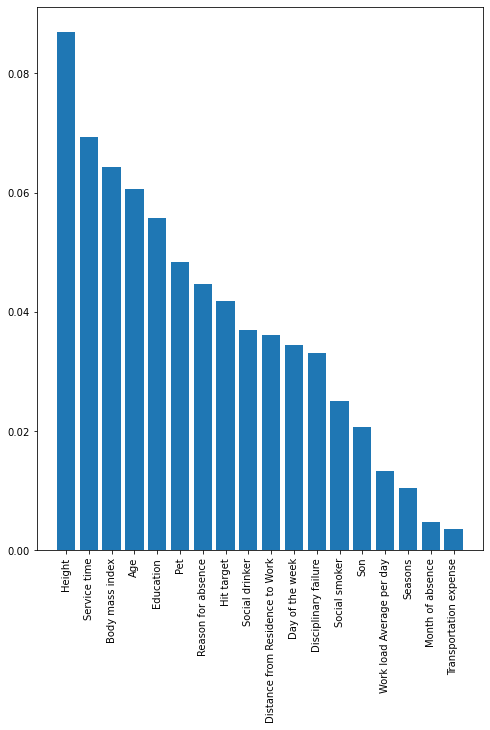

In [25]:
plt.figure(figsize=(8,10))
plt.bar(x=feature_best.index[1:],height=feature_best[1:].values)
plt.xticks(rotation = 90);

# 7. Áp dụng lại Random Forest cho thuộc tính quan trọng.

In [26]:
X_best = X[['Height', 'Service time', 'Body mass index', 'Age', 'Education']]

In [27]:
X_best_train, X_best_test, y_best_train, y_best_test = train_test_split(X_best,y,test_size = 0.3)

In [28]:
model_best = RandomForestRegressor()
model_best.fit(X_best_train,y_best_train)

RandomForestRegressor()

In [29]:
y_best_pred = model_best.predict(X_best_test)

# 8. Kiểm tra độ chính xác

In [30]:
#R2 toàn bộ dữ liệu:
model_best.score(X_best,y)

0.07701618108900943

In [31]:
#R2 train:
model_best.score(X_best_train,y_best_train)

0.10675142324407716

In [32]:
#R2 test:
model_best.score(X_best_test,y_best_test)

0.008067460480247535

In [33]:
#MSE:
mean_squared_error(y_best_test,y_best_pred)

184.9493322239469

In [34]:
#MAE:
mean_absolute_error(y_best_test,y_best_pred)

6.415682840333088

##### Nhận xét:
Sử dụng các thuộc tính quan trọng không cho kết quả cải thiện hơn.

# Xử lý Target

In [56]:
df[['Reason for absence']].groupby(df['Absenteeism time in hours']).count()

,Reason for absence
Absenteeism time in hours,
0,41
1,85
2,137
3,102
4,60
5,7
7,1
8,207
16,19


In [57]:
df.head()

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average per day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Height,Body mass index,Absenteeism time in hours
0,26,7,3,1,289,36,13,33,239.554,97,0,1,2,1,0,1,172,30,4
1,0,7,3,1,118,13,18,50,239.554,97,1,1,1,1,0,0,178,31,0
2,23,7,4,1,179,51,18,38,239.554,97,0,1,0,1,0,0,170,31,2
3,7,7,5,1,279,5,14,39,239.554,97,0,1,2,1,1,0,168,24,4
4,23,7,5,1,289,36,13,33,239.554,97,0,1,2,1,0,1,172,30,2


In [59]:
# Nhóm nghỉ theo giờ:
df_1day_off = df[df['Absenteeism time in hours'] <= 8]

In [60]:
#Nhóm nghỉ theo ngày:
df_duration = df[df['Absenteeism time in hours'] > 8]

In [64]:
df_1day_off['Absent_clf'] = df['Absenteeism time in hours'].map(lambda x: 1 if (x>1 and x <=4) else( 2 if x >4 else 0))

<ipython-input-64-550db1bd09ce>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1day_off['Absent_clf'] = df['Absenteeism time in hours'].map(lambda x: 1 if (x>1 and x <=4) else( 2 if x >4 else 0))


In [66]:
df_1day_off.head()

,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average per day,Hit target,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Height,Body mass index,Absenteeism time in hours,Absent_clf
0,26,7,3,1,289,36,13,33,239.554,97,0,1,2,1,0,1,172,30,4,1
1,0,7,3,1,118,13,18,50,239.554,97,1,1,1,1,0,0,178,31,0,0
2,23,7,4,1,179,51,18,38,239.554,97,0,1,0,1,0,0,170,31,2,1
3,7,7,5,1,279,5,14,39,239.554,97,0,1,2,1,1,0,168,24,4,1
4,23,7,5,1,289,36,13,33,239.554,97,0,1,2,1,0,1,172,30,2,1


In [80]:
from sklearn.preprocessing import RobustScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score, KFold
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

In [68]:
X1_clf = df_1day_off.drop(['Absenteeism time in hours','Absent_clf'],axis=1)
y1_clf = df_1day_off.Absent_clf

In [72]:
X_train,X_test,y_train,y_test = train_test_split(X1_clf,y1_clf)

In [81]:
k_feature = SelectKBest(score_func=f_classif,k=5)

In [83]:
pipe_RF = Pipeline([('Rb',RobustScaler()),
                    ('kbest',k_feature),
                    ('Rf',RandomForestClassifier()),
                   ])

In [91]:
pipe_RF.fit(X_train,y_train)

Pipeline(steps=[('Rb', RobustScaler()), ('kbest', SelectKBest(k=5)),
                ('Rf', RandomForestClassifier())])

In [92]:
pipe_RF.score(X_train,y_train)

0.9791666666666666

In [93]:
pipe_RF.score(X_test,y_test)

0.725

##### Nhận xét:
Độ chính xác của thuật toán được cải thiện đáng kể